In [1]:
import glob
import os
import numpy as np
import pandas as pd
import scipy.signal
import skimage
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.collections import LineCollection
from matplotlib.colors import ListedColormap, BoundaryNorm

plt.style.use('styleNB.mplstyle')
   
ip = 200.0/303.0

/Users/nathanb/git/CRISPRi_screen_galvanotaxis/code/exploratory/../../../bebi103/viz.py:29: UserWarning: DataShader import failed with error "No module named 'datashader.bokeh_ext'".
Features requiring DataShader will not work and you will get exceptions.
  warnings.warn(f"""DataShader import failed with error "{e}".
/Users/nathanb/git/CRISPRi_screen_galvanotaxis/code/exploratory/../../../bebi103/viz.py:38: UserWarning: Could not import `stan` submodule. Perhaps pystan is not properly installed.
  warnings.warn('Could not import `stan` submodule. Perhaps pystan is not properly installed.')
/Users/nathanb/git/CRISPRi_screen_galvanotaxis/code/exploratory/../../../bebi103/__init__.py:19: UserWarning: Could not import `stan` submodule. Perhaps pystan is not properly installed.
  warnings.warn('Could not import `stan` submodule. Perhaps pystan is not properly installed.')


## Grab data

lets grab the files I'll be working with. In this experiment I look ~30 min videos (60 sec  intervals, 30 frames), 3 $\mu$m slides over 300 $\mu$m - using the water 20x objective. One channel is phase, while the other is the DNA (using Heocht stain at 1 $\mu$g/ml for 15 min in flask prior to cell collection).  I took data at 0V/cm, 3 V/cm, and 5 V/cm. Note that in this batch of knockdown lines (i.e. performed fall of 2023) I also performed a density gradient clean up for all preps (using Polymorpprep).

In [16]:
filelist = glob.glob(f_dir + 'processed_tracking/2023*KD_lines/*.csv')
print(filelist)

['../../data/processed_tracking/20231005_KD_lines/20231005_dHL60_sgControl_20xWl_60secFR_3umZ_0Vcm_1_tracks.csv', '../../data/processed_tracking/20231005_KD_lines/20231005_dHL60_sgVPS13B_20xWl_60secFR_3umZ_3Vcm_1_tracks.csv', '../../data/processed_tracking/20231005_KD_lines/20231005_dHL60_sgGNPNAT1_20xWl_60secFR_3umZ_0Vcm_1_tracks.csv', '../../data/processed_tracking/20231005_KD_lines/20231005_dHL60_sgVPS13B_20xWl_60secFR_3umZ_5Vcm_1_tracks.csv', '../../data/processed_tracking/20231005_KD_lines/20231005_dHL60_sgGNPNAT1_20xWl_60secFR_3umZ_3Vcm_1_tracks.csv', '../../data/processed_tracking/20231005_KD_lines/20231005_dHL60_sgVPS13B_20xWl_60secFR_3umZ_0Vcm_1_tracks.csv', '../../data/processed_tracking/20231005_KD_lines/20231005_dHL60_sgControl_20xWl_60secFR_3umZ_3Vcm_1_tracks.csv', '../../data/processed_tracking/20231005_KD_lines/20231005_dHL60_sgControl_20xWl_60secFR_3umZ_5Vcm_1_tracks.csv', '../../data/processed_tracking/20231004_KD_lines/20231004_dHL60_sgGNPNAT1_20xWl_60secFR_3umZ_5Vcm_

In [1]:
# df = pd.DataFrame()

for file in filelist:
    if np.all(['202310' in file, 'sgGNP' in file]):
        continue
    if 'sg' not in file:
        continue
    df_temp = pd.read_csv(file, skiprows=[0,2,3,4])
    df_temp = df_temp[['Track ID', 'Frame', 'X', 'Y', 'Z']]
    df_temp.columns = ['cell', 'frame', 'x', 'y', 'z']

    df_temp['celltype'] = 'sg'+file.split('_sg')[-1].split('_')[0]
    df_temp['acqtime'] = '60sec'
    df_temp['E_V_cm'] = file.split('Vcm')[0].split('_')[-1]
    df_temp['date'] = file.split('_KD_lines/')[-1].split('_')[0]
    df_temp['material'] = 'collagen'
    df_temp['concentration'] = '0.75 mg/ml'
    df_temp['scope'] = 'Sydney'
    df_temp['magnification'] = '20xWater'
    df_temp['trial'] = file.split('3um')[-1].split('.csv')[0].split('Vcm_')[-1].split('_')[0]
    df_temp['media'] = 'L15 10%FBS'
    df_temp['analysis_date'] = '20231002'

    df = pd.concat([df, df_temp], ignore_index = True)


NameError: name 'filelist' is not defined

In [2]:
# df_groups = df.groupby(['celltype', 'E_V_cm', 'trial', 'date'])
# for i, data in df_groups:
#     print(i)

In [19]:
df = df[['cell', 'frame', 'x', 'y', 'z', 'celltype', 
      'E_V_cm', 'date', 'trial']]

In [20]:
df = df[~df.isin([np.nan, np.inf, -np.inf]).any(1)]

In [21]:
# remove cells that were not detected in every frame (I don't think this is actually needed)
df_temp = pd.DataFrame()
for sg, d in df.groupby(['celltype', 'E_V_cm', 'date', 'trial', 'cell']):
#     print(sg)
    if (len(d.frame.unique())-1) == (d.frame.max() - d.frame.min()):
        df_temp = df_temp.append(d, ignore_index = True)

/var/folders/hs/8f67z23n6g9g9g4y03yhrn_c0000gn/T/ipykernel_29981/4244195761.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_temp = df_temp.append(d, ignore_index = True)


In [22]:
df = df_temp.sort_values(['frame', 'cell'])

In [23]:
# number of cells in data
for sg, d in df.groupby(['celltype', 'E_V_cm']):
    print(sg)
    
    count = 0
    for g, d_ in d.groupby(['cell', 'date', 'trial']):
        count += 1
    print(count)

('sgControl', '0')
1477
('sgControl', '3')
1503
('sgControl', '5')
1585
('sgControl1', '3')
492
('sgControl1', '5')
527
('sgFH', '0')
1481
('sgFH', '3')
1511
('sgFH', '5')
1535
('sgGNPNAT1-A', '0')
321
('sgGNPNAT1-A', '3')
370
('sgGNPNAT1-A', '5')
396
('sgGNPNAT1-B', '0')
730
('sgGNPNAT1-B', '3')
885
('sgGNPNAT1-B', '5')
809
('sgTMEM154', '0')
2051
('sgTMEM154', '3')
1941
('sgTMEM154', '5')
2070
('sgUXS1', '0')
1395
('sgUXS1', '3')
1480
('sgUXS1', '5')
1443
('sgVPS13B', '0')
1612
('sgVPS13B', '3')
1925
('sgVPS13B', '5')
1977


## Visualize all tracks

sgControl
('0', '20230928', '1')
('0', '20231004', '1')
('0', '20231005', '1')
('3', '20230928', '1')
('3', '20231004', '2')
('3', '20231005', '1')
('5', '20230928', '2')
('5', '20231004', '1')
('5', '20231005', '1')
sgControl1
('3', '20231102', '1')
('5', '20231102', '2')
sgFH
('0', '20231102', '1')
('0', '20231102', 'prep2')
('0', '20231103', '1')
('3', '20231102', '1')
('3', '20231102', 'prep2')
('3', '20231103', '1')
('5', '20231102', '1')
('5', '20231102', 'prep2')
('5', '20231103', '1')
sgGNPNAT1-A
('0', '20231101', '1')
('3', '20231101', '1')
('5', '20231101', '1')
sgGNPNAT1-B
('0', '20231102', '1')
('0', '20231102', '2')
('3', '20231102', '1')
('3', '20231103', '1')
('5', '20231102', '1')
('5', '20231103', '1')
sgTMEM154
('0', '20230928', '1')
('0', '20230929', '1')
('0', '20230929', '2')
('3', '20230928', '1')
('3', '20230929', '1')
('3', '20230929', '2')
('5', '20230928', '1')
('5', '20230929', '1')
('5', '20230929', '2')
sgUXS1
('0', '20231101', '1')
('0', '20231102', '1')
(

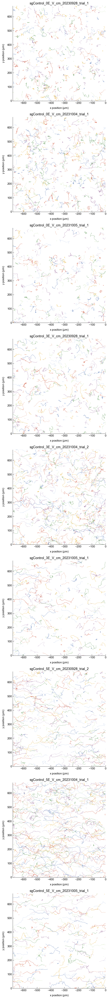

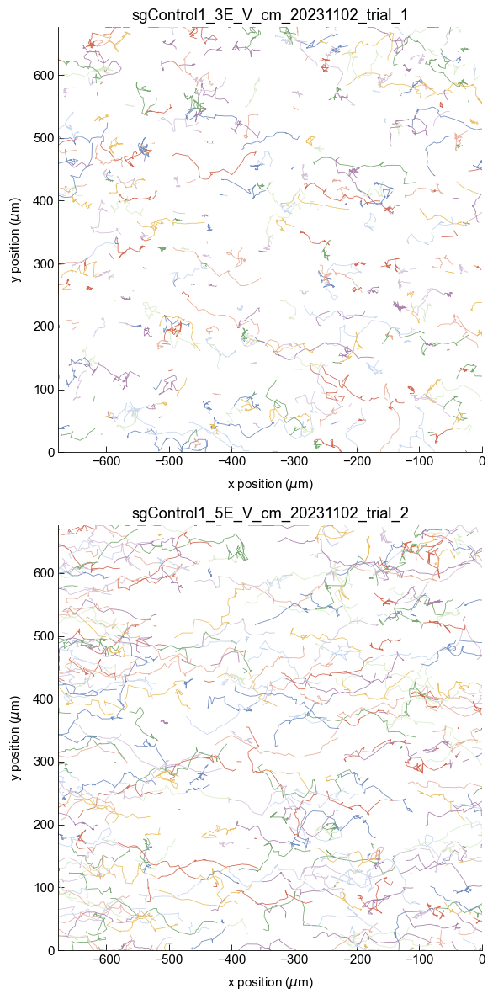

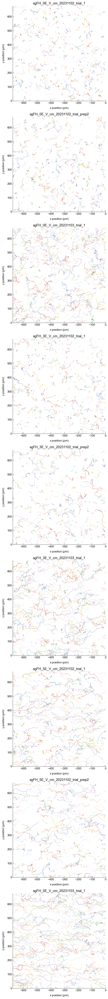

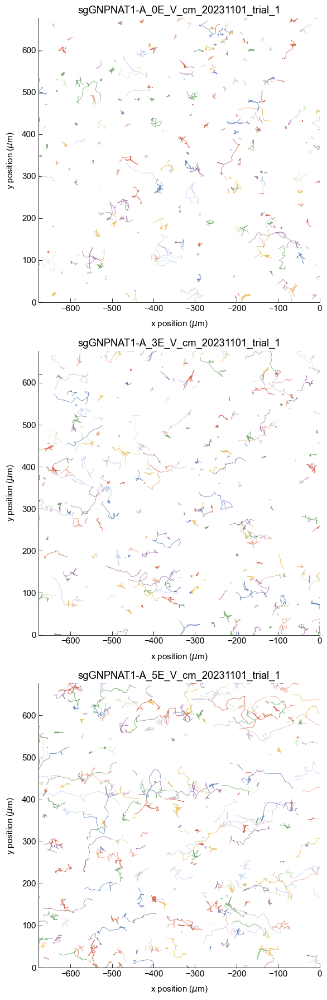

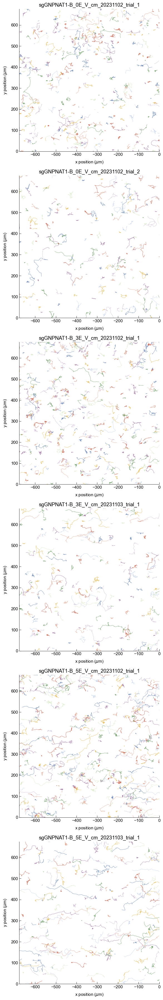

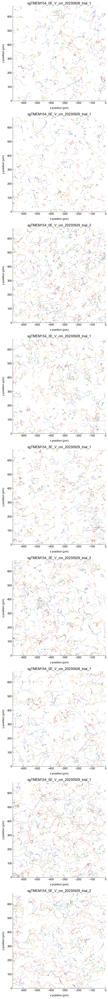

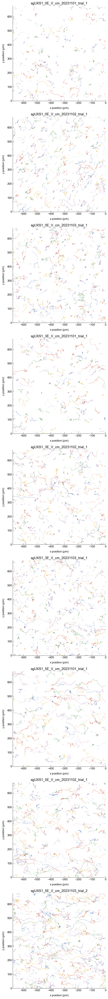

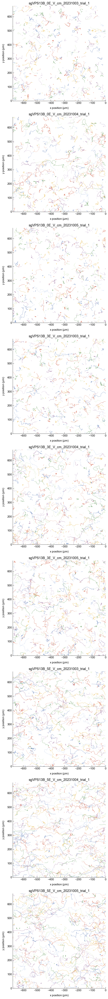

In [24]:
for sg, d in df.groupby(['celltype']):
    print(sg)
    
    count = 0
    for g, d_ in d.groupby(['E_V_cm', 'date', 'trial']):
        count += 1

    f, ax = plt.subplots(count, 1, figsize=(6,count*6))    
    ax = ax.ravel()


    aq = 0
    for g, d_ in d.groupby(['E_V_cm', 'date', 'trial']):
        print(g)
            
        ##################################
        # plot tracks
        ##################################
        num_cells = len(d_.cell.unique())
        for i in np.arange(0,num_cells):
            data_ = d_[d_.cell==i]

            data_ = data_.replace([np.inf, -np.inf], np.nan)
            d_x = data_.x[~np.isnan(data_.x)] 
            d_y = data_.y[~np.isnan(data_.y)] 
            d_z = data_.z[~np.isnan(data_.z)] 
           
            if len(d_x)==0:
                continue

            x = data_.x.values 
            y = data_.y.values 
            z = data_.z.values 


            ax[aq].plot(data_.x.values - 1024.0*ip, 
                           1024.0*ip - data_.y.values)
            ax[aq].set_xlabel('x position ($\mu$m)')
            ax[aq].set_ylabel('y position ($\mu$m)')
            ax[aq].set_xlim(-676,0)
            ax[aq].set_ylim(0,676)
            ax[aq].set_title(sg + '_' + str(g[0]) + 'E_V_cm_' + str(g[1]) +
                             '_trial_' + str(g[2]))# + ', ' + g[0] + '\n' + 'date: ' + str(g[2]) + ', trial: ' + str(g[3]))


            
        aq += 1
        
    plt.tight_layout()

In [ ]:
# notes on any samples that will be harder to perform drift correction (since I expect 
# a few based on some of the issues I encountered during imaging)
# my code below will work best for drift along horizontal axis, which is most common across my data. 

# Look more closely at :

# UXS1
# 0V/cm 20231102 - diagonal dirft

# Also Look more closely at original data for:

# Control
# 3V/cm 20231102_1


## Drift correction and identify motile cells

I need to modify this so that I can see the cells that were identified as nonmotile and maybe also those cells that were excluded. It would be nice to have a nice by side of the uncorrected & drift-corrected.

sgControl
('0', '20230928', '1')
[  3.   8.  10.  17.  21.  27.  28.  31.  38.  39.  46.  51.  56.  57.
  61.  66.  81.  82.  84.  94.  95.  96. 100. 101. 102. 103. 104. 107.
 108. 110. 114. 116. 127. 133. 135. 144. 145. 149. 151. 155. 156. 157.
 160. 162. 165. 166. 169. 170. 171. 172. 174. 175. 178. 186. 193. 203.
 207. 208. 209. 220. 232. 235. 237. 241. 243. 246. 247. 258. 260. 263.
 265. 267. 268. 270. 285. 290. 297. 302. 306. 309. 314. 318. 319. 330.
 332. 333. 334. 338. 356. 358. 360. 362.]
('0', '20231004', '1')
[ 32.  42.  47.  50.  61.  70.  84.  95. 111. 116. 119. 133. 144. 163.
 165. 170. 173. 178. 180. 190. 221. 229. 238. 243. 246. 251. 252. 255.
 258. 272. 275. 277. 295.]
('0', '20231005', '1')
[  9.  13.  31.  35.  58.  62.  70.  88.  91.  96. 107. 120. 123. 124.
 131. 140. 149. 152. 165. 167. 176. 198. 203.]
('3', '20230928', '1')
[  3.  15.  17.  36.  40.  50.  53.  55.  61.  70.  77.  87.  88.  90.
  95. 123. 126. 128. 134. 137. 142. 146. 150. 155. 165. 166. 167. 171.
 

('0', '20230929', '1')
[  2.   8.  11.  14.  15.  16.  17.  22.  25.  31.  40.  42.  46.  50.
  51.  59.  63.  69.  70.  73.  85.  87.  90.  94.  95.  98.  99. 102.
 106. 107. 108. 111. 120. 123. 124. 129. 133. 134. 137. 139. 146. 147.
 149. 153. 155. 158. 161. 167. 172. 174. 177. 185. 186. 187. 194. 195.
 198. 201. 202. 205. 210. 212. 217. 227. 232. 240. 246. 252. 253. 255.
 258. 262. 270. 276. 278. 282. 286. 287. 288. 290. 291. 298. 308. 312.
 314. 328. 330. 335.]
('0', '20230929', '2')
[ 11.  29.  30.  32.  33.  41.  44.  57.  68.  71.  91. 104. 117. 137.
 154. 159. 172. 176. 178. 196. 199. 203. 211. 215. 219. 224. 229. 246.
 250. 252. 256. 258. 287. 305. 330. 335. 338. 339. 349. 352. 353. 354.
 359. 361. 373. 386. 388. 392. 396. 397. 404. 425. 429. 432. 436. 449.
 461. 476. 482. 485. 494. 503. 521.]
('3', '20230928', '1')
[  5.  44.  85.  89. 142. 157. 164. 187. 211. 326. 332.]
('3', '20230929', '1')
[ 17.  28.  29.  31.  32.  33.  39.  42.  54.  59.  60.  73.  74.  76.
  81.  93. 

('5', '20231003', '1')
[ 13.  16.  19.  22.  23.  25.  30.  39.  70.  88.  89.  91.  92. 110.
 112. 122. 125. 138. 145. 154. 161. 176. 177. 181. 182. 186. 214. 218.
 220. 224. 227. 231. 240. 242. 246. 259. 262. 266. 267. 268. 272. 273.
 283. 296. 309. 315. 320. 323. 335. 337. 338. 339. 348. 350. 351. 352.
 360. 369. 377. 382. 386. 391. 392. 393. 408. 417. 424.]
('5', '20231004', '1')
[  3.  14.  23.  25.  31.  38.  39.  41.  54.  56.  57.  65.  67.  71.
  74.  75.  76.  77.  78.  83.  90. 102. 107. 114. 117. 132. 136. 137.
 139. 148. 151. 163. 166. 170. 181. 200. 221. 222. 223. 224. 244. 249.
 251. 262. 271. 281. 283. 285. 300. 318. 326. 330. 334. 335. 347. 359.
 362. 363.]
('5', '20231005', '1')
[  1.   3.  13.  20.  26.  28.  30.  33.  42.  47.  51.  57.  61.  65.
  77.  78.  82.  85.  92.  94.  98. 107. 109. 114. 122. 123. 128. 147.
 155. 163. 165. 168. 172. 175. 188. 194. 198. 200. 203. 208. 210. 220.
 228. 230. 239. 245. 249. 258. 263. 270. 272. 274. 276. 279. 280. 284.
 287. 290.

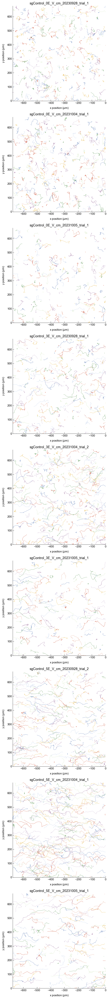

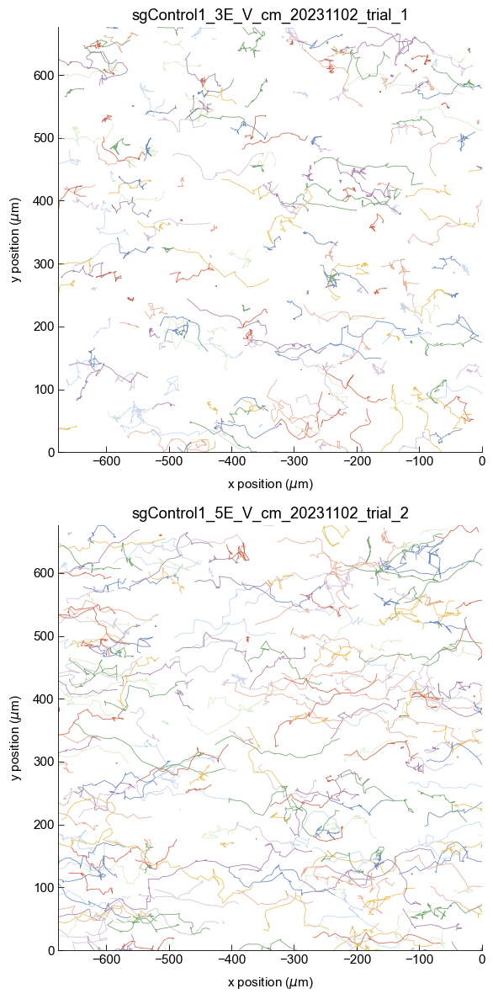

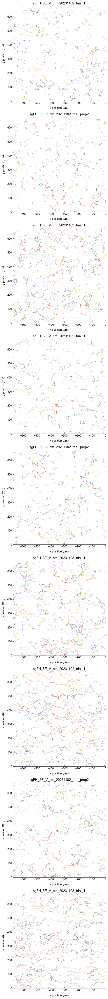

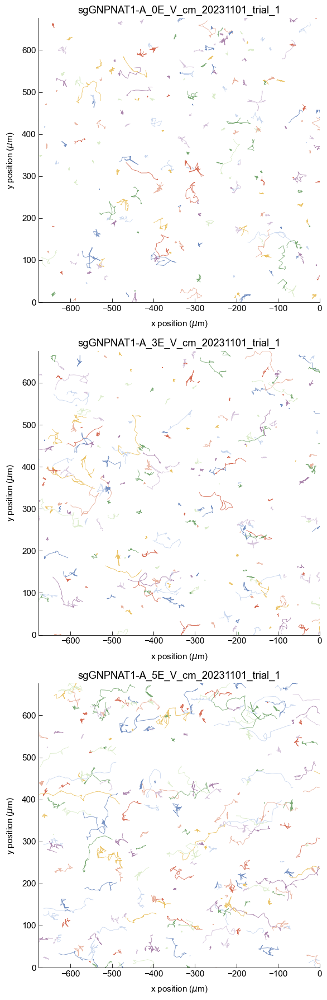

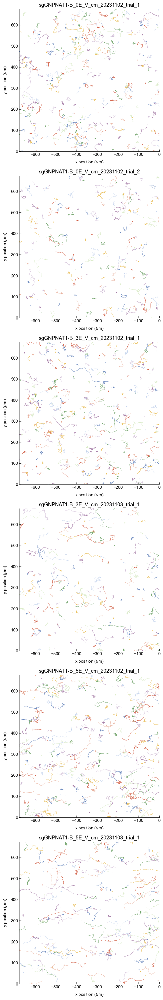

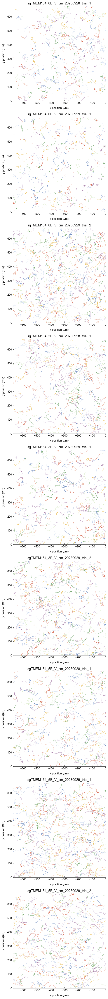

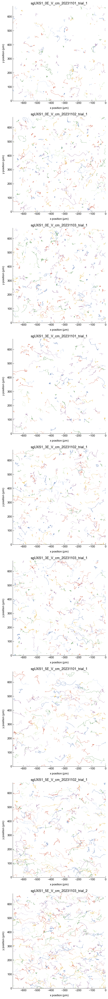

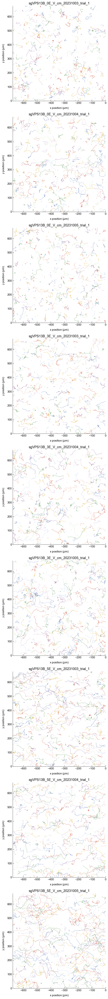

In [156]:
# determine xy shift for  drift correction
#  Only worry about cells quantified throughout time series.
# generate a dictionary for x and y 

df_filtered = pd.DataFrame()
df_ignore_nonmotile = pd.DataFrame()
df_ignore_other = pd.DataFrame()

for sg, d in df.groupby(['celltype']):
    print(sg)

    count = 0
    for g, d_ in d.groupby(['E_V_cm', 'date', 'trial']):
        count += 1

    f, ax = plt.subplots(count, 1, figsize=(6,count*6))    
    ax = ax.ravel()

    aq = 0
    for g, d_ in d.groupby(['E_V_cm', 'date', 'trial']):
        print(g)
        if np.all([sg == 'sgFH', g[1] == '20231103']):
            tot_len = 25
        else:
            tot_len = 30
        
        ##################################
        # identify non-motile cells for drift correction
        ##################################

        nonmotile_cells = []
        for i in d_.cell.unique():
            data_ = d_[d_.cell==i]

            data_ = data_.replace([np.inf, -np.inf], np.nan)
            d_x = data_.x[~np.isnan(data_.x)] 
            d_y = data_.y[~np.isnan(data_.y)] 
            d_z = data_.z[~np.isnan(data_.z)] 

            if len(d_x) == tot_len:
                if np.all([sg == 'sgUXS1', g[0] == '0', g[1] == '20231102']):
                    if np.all([np.ptp(d_x)<=20.0, np.ptp(d_y)<=20.0]):
                        nonmotile_cells = np.append(nonmotile_cells, i)    
                else:
                    if np.any([np.ptp(d_x)<=5.0, np.ptp(d_y)<=5.0]):
                        nonmotile_cells = np.append(nonmotile_cells, i)    

        s_x = [0]
        s_y = [0]
        s_z = [0]
        df_nonmotile = d_[d_.cell.isin(nonmotile_cells)]

        for t in np.arange(0,tot_len):
            if t == 0:
                continue
            shift_temp_x = []
            shift_temp_y = []
            shift_temp_z = []
            for cell, d_nm in df_nonmotile.groupby('cell'):
                shift_temp_x = np.append(shift_temp_x, d_nm[d_nm.frame==t].x.values - d_nm[d_nm.frame==t-1].x.values)
                shift_temp_y = np.append(shift_temp_y, d_nm[d_nm.frame==t].y.values - d_nm[d_nm.frame==t-1].y.values)
                shift_temp_z = np.append(shift_temp_z, d_nm[d_nm.frame==t].z.values - d_nm[d_nm.frame==t-1].z.values)
            
            s_x = np.append(s_x, np.mean(shift_temp_x))
            s_y = np.append(s_y, np.mean(shift_temp_y))
            s_z = np.append(s_z, np.mean(shift_temp_z))
        
        print(nonmotile_cells)
            
        ##################################
        # Apply drift correction, plot, and save motile cell track data
        ##################################

        for i in d_.cell.unique():
            data_ = d_[d_.cell==i]

            data_ = data_.replace([np.inf, -np.inf], np.nan)
            d_x = data_.x[~np.isnan(data_.x)] 
            d_y = data_.y[~np.isnan(data_.y)] 
            d_z = data_.z[~np.isnan(data_.z)] 
           
            if len(d_x)==0:
                continue

            if len(d_x) >=15:
                if len(df_nonmotile) == 0:
                    data_['x_shifted'] = data_['x']
                    data_['y_shifted'] = data_['y']
                    data_['z_shifted'] = data_['z']
                    d_s_x = data_.x_shifted
                    d_s_y = data_.y_shifted
                    d_s_z = data_.z_shifted
                else:
                    x = data_.x.values - np.cumsum(s_x[int(data_.frame.min()):int(data_.frame.max())+1])
                    y = data_.y.values - np.cumsum(s_y[int(data_.frame.min()):int(data_.frame.max())+1])
                    z = data_.z.values - np.cumsum(s_z[int(data_.frame.min()):int(data_.frame.max())+1])
                    data_['x_shifted'] = x
                    data_['y_shifted'] = y
                    data_['z_shifted'] = z
                    d_s_x = data_.x_shifted
                    d_s_y = data_.y_shifted
                    d_s_z = data_.z_shifted
   

                ax[aq].plot(data_.x.values - 1024.0*ip - np.cumsum(s_x[int(data_.frame.min()):int(data_.frame.max())+1]), 
                               1024.0*ip - data_.y.values + np.cumsum(s_y[int(data_.frame.min()):int(data_.frame.max())+1]))
                ax[aq].set_xlabel('x position ($\mu$m)')
                ax[aq].set_ylabel('y position ($\mu$m)')
                ax[aq].set_xlim(-676,0)
                ax[aq].set_ylim(0,676)
                ax[aq].set_title(sg + '_' + str(g[0]) + 'E_V_cm_' + str(g[1]) +
                                 '_trial_' + str(g[2]))
                

                #########################
                # save to dataframe
                #########################            
                if i in nonmotile_cells:
                    df_ignore_nonmotile = pd.concat([df_ignore_nonmotile, data_], 
                                             ignore_index = True)
                    
                elif np.sqrt(np.ptp(d_s_x)**2 + np.ptp(d_s_y)**2 + np.ptp(d_s_z)**2) >=20:
                
                    df_filtered = pd.concat([df_filtered, data_], 
                                            ignore_index = True)
                    
                else:
                    df_ignore_other = pd.concat([df_ignore_other, data_], 
                                          ignore_index = True)
            
        aq += 1
        
    plt.tight_layout()

sgControl
sgControl1
sgFH
sgGNPNAT1-A
sgGNPNAT1-B
sgTMEM154
sgUXS1
sgVPS13B


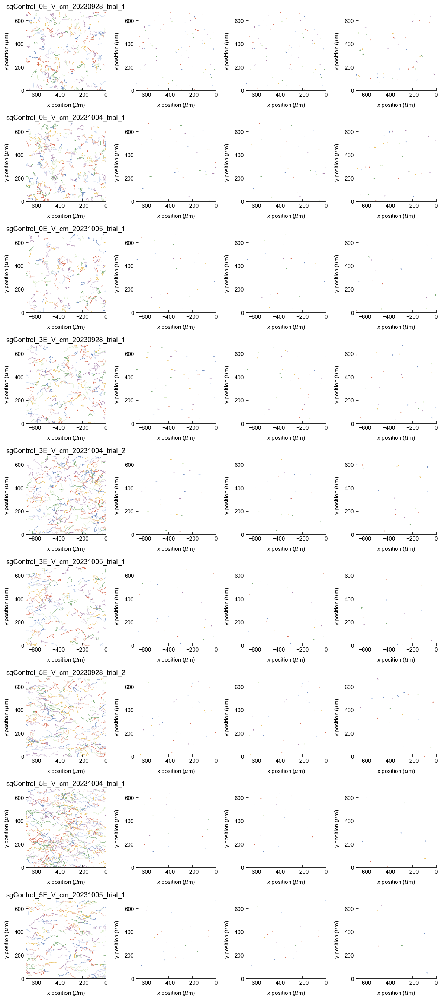

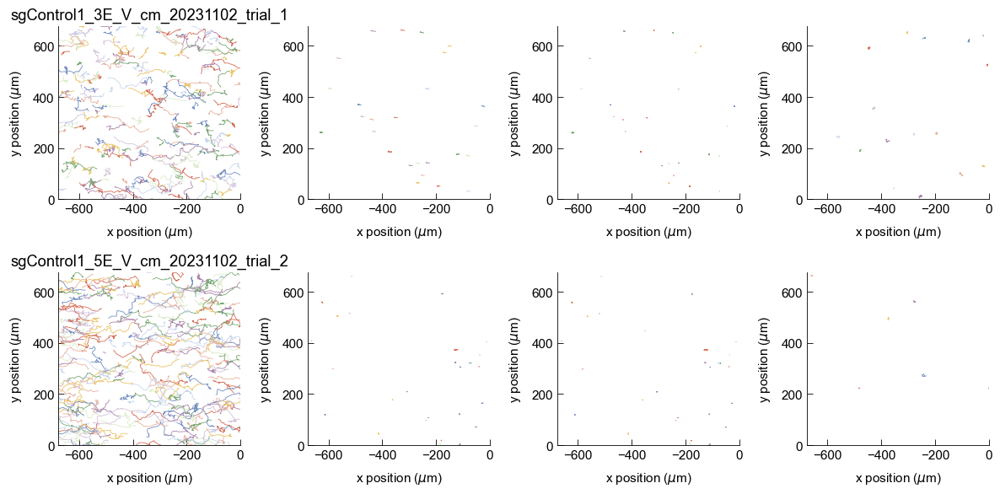

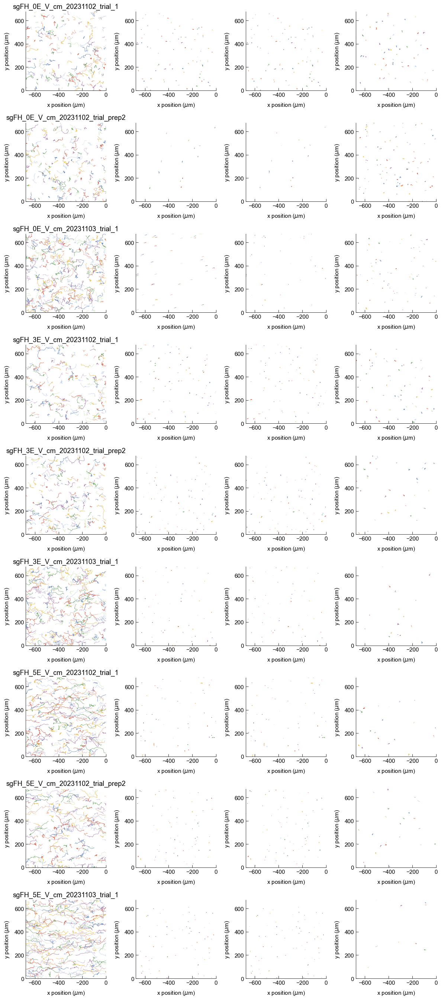

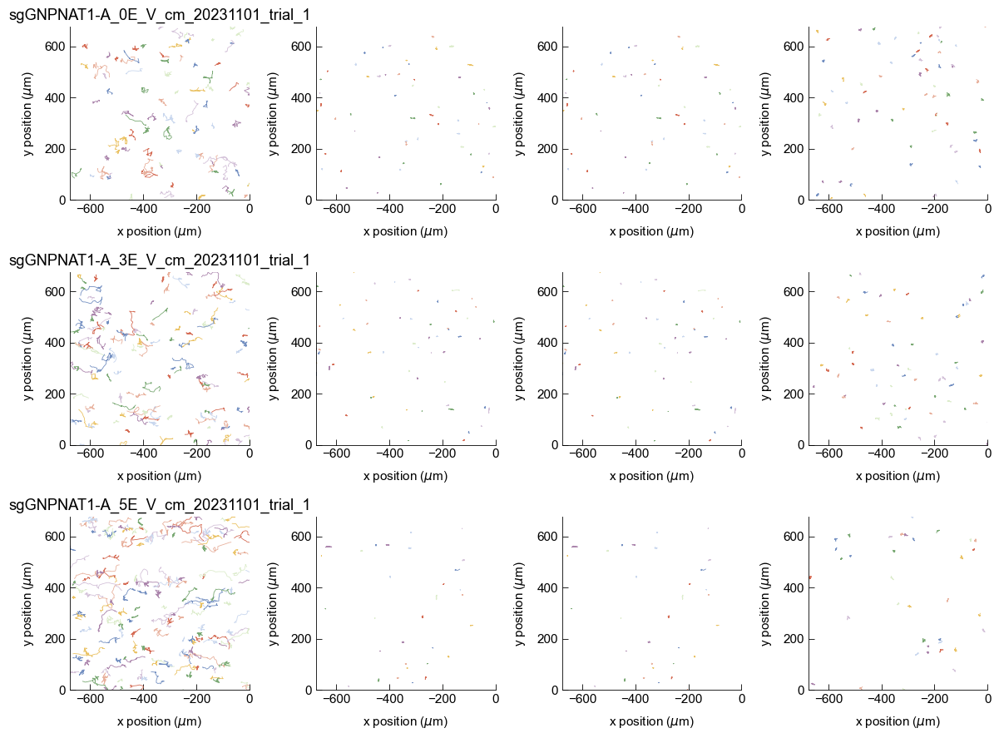

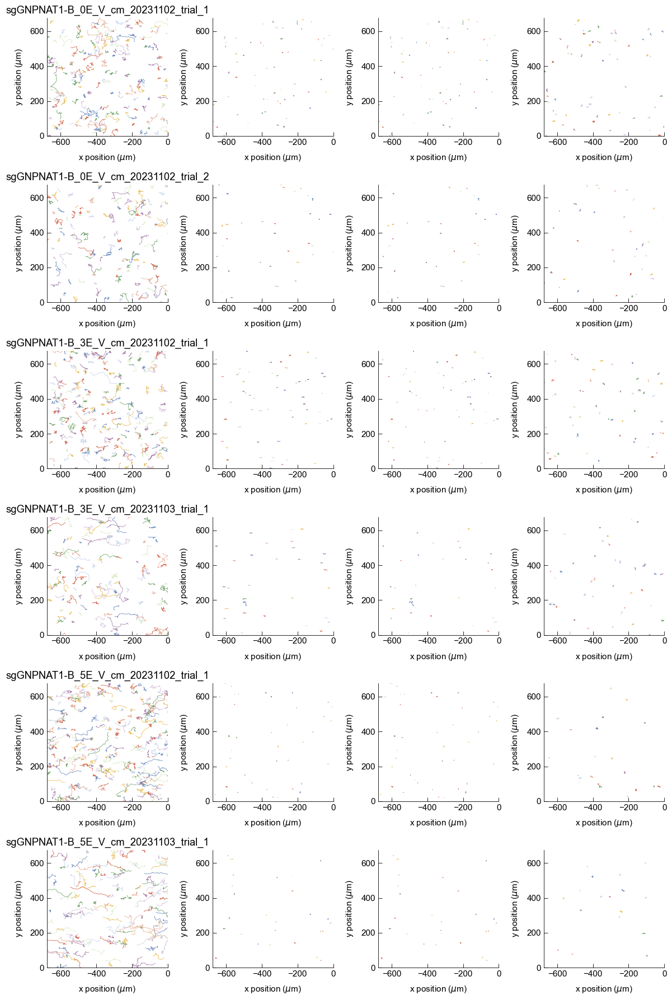

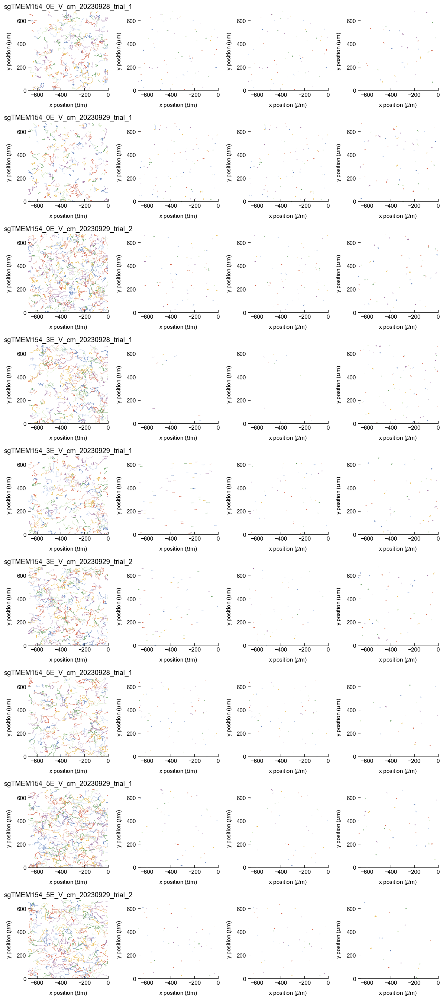

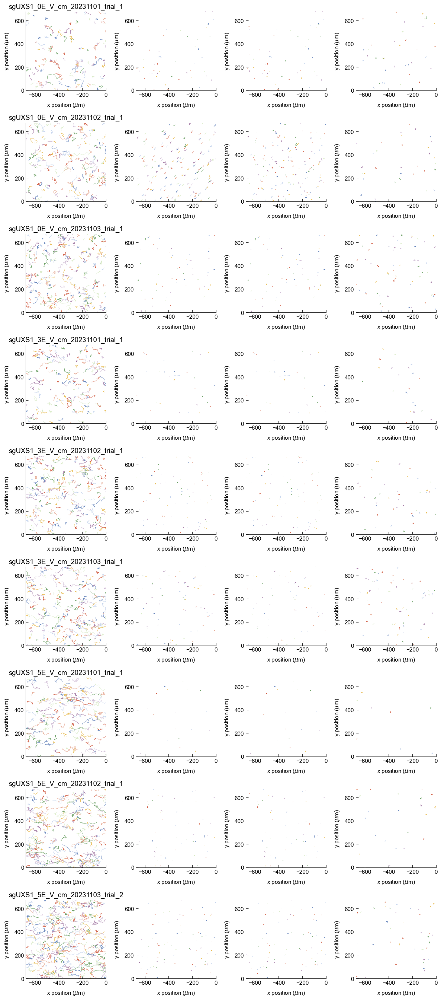

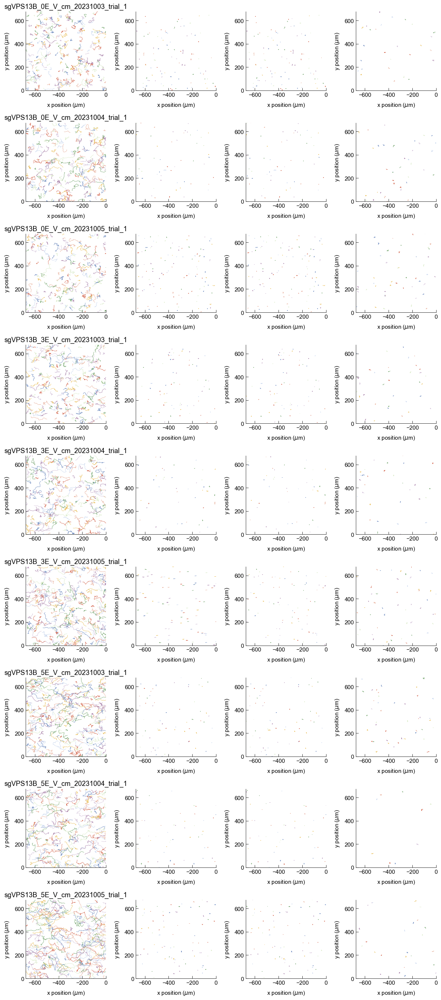

In [158]:
for sg, d in df_filtered.groupby(['celltype']):
    count = 0
    for g, d_ in d.groupby(['E_V_cm', 'date', 'trial']):
        count += 1

    f, ax = plt.subplots(count, 4, figsize=(12,count*3))    

    aq = 0
    for g, d_ in d.groupby(['E_V_cm', 'date', 'trial']):
            
        ##################################
        # plot tracks
        ##################################
#         num_cells = len(d_.cell.unique())
        for i in d_.cell.unique():
            data_ = d_[d_.cell==i]

            data_ = data_.replace([np.inf, -np.inf], np.nan)
            d_x = data_.x[~np.isnan(data_.x)] 
           
            if len(d_x)==0:
                continue

            ax[aq, 0].plot(data_.x_shifted.values - 1024.0*ip, 
                           1024.0*ip - data_.y_shifted.values)
            ax[aq, 0].set_xlabel('x position ($\mu$m)')
            ax[aq, 0].set_ylabel('y position ($\mu$m)')
            ax[aq, 0].set_xlim(-676,0)
            ax[aq, 0].set_ylim(0,676)
            ax[aq, 0].set_title(sg + '_' + str(g[0]) + 'E_V_cm_' + str(g[1]) +
                             '_trial_' + str(g[2]))
            
        aq += 1

    ##################################
    # non motile cells - uncorrected
    ##################################    
    d = df_ignore_nonmotile[df_ignore_nonmotile.celltype == sg]
    print(sg)
    aq = 0
    for g, d_ in d.groupby(['E_V_cm', 'date', 'trial']):
            
        ##################################
        # plot tracks
        ##################################
#         num_cells = len(d_.cell.unique())
#         print(num_cells)
#         if sg == 'sgFH':
#             print(d_.x.values)
        for i in d_.cell.unique():
            data_ = d_[d_.cell==i]

            data_ = data_.replace([np.inf, -np.inf], np.nan)
            d_x = data_.x[~np.isnan(data_.x)] 
           
            if len(d_x)==0:
                continue

            ax[aq, 1].plot(data_.x.values - 1024.0*ip, 
                           1024.0*ip - data_.y.values)
            ax[aq, 1].set_xlabel('x position ($\mu$m)')
            ax[aq, 1].set_ylabel('y position ($\mu$m)')
            ax[aq, 1].set_xlim(-676,0)
            ax[aq, 1].set_ylim(0,676)
            
        aq += 1
        
    ##################################
    # non motile cells - corrected
    ##################################        
    d = df_ignore_nonmotile[df_ignore_nonmotile.celltype == sg]
    aq = 0
    for g, d_ in d.groupby(['E_V_cm', 'date', 'trial']):
            
        ##################################
        # plot tracks
        ##################################
#         num_cells = len(d_.cell.unique())
        for i in d_.cell.unique():
            data_ = d_[d_.cell==i]

            data_ = data_.replace([np.inf, -np.inf], np.nan)
            d_x = data_.x[~np.isnan(data_.x)] 
           
            if len(d_x)==0:
                continue

            ax[aq, 2].plot(data_.x_shifted.values - 1024.0*ip, 
                           1024.0*ip - data_.y_shifted.values)
            ax[aq, 2].set_xlabel('x position ($\mu$m)')
            ax[aq, 2].set_ylabel('y position ($\mu$m)')
            ax[aq, 2].set_xlim(-676,0)
            ax[aq, 2].set_ylim(0,676)
            
        aq += 1
 
    d = df_ignore_other[df_ignore_other.celltype == sg]
    aq = 0
    for g, d_ in d.groupby(['E_V_cm', 'date', 'trial']):
            
        ##################################
        # plot tracks
        ##################################
#         num_cells = len(d_.cell.unique())
        for i in d_.cell.unique():
            data_ = d_[d_.cell==i]

            data_ = data_.replace([np.inf, -np.inf], np.nan)
            d_x = data_.x[~np.isnan(data_.x)] 

           
            if len(d_x)==0:
                continue

            ax[aq, 3].plot(data_.x_shifted.values - 1024.0*ip, 
                           1024.0*ip - data_.y_shifted.values)
            ax[aq, 3].set_xlabel('x position ($\mu$m)')
            ax[aq, 3].set_ylabel('y position ($\mu$m)')
            ax[aq, 3].set_xlim(-676,0)
            ax[aq, 3].set_ylim(0,676)
          
            
        aq += 1
            
        
        
    plt.tight_layout()

In [159]:
df_filtered['x'] = df_filtered['x_shifted'] 
df_filtered['y'] = df_filtered['y_shifted'] 
df_filtered['z'] = df_filtered['z_shifted'] 

In [171]:
# correct some names
df_filtered = df_filtered.replace('sgControl1', 'sgControl')
df_filtered = df_filtered.replace('sgGNPNAT1-A', 'sgGNPNAT1')
df_filtered = df_filtered.replace('sgGNPNAT1-B', 'sgGNPNAT1')

## Plot trajectories and save to file

In [172]:
for g, d in df_filtered.groupby(['celltype', 'E_V_cm', 'trial', 'date']):

    num_cells = len(d.cell.unique())
#     print(g, num_cells)
    ###################################################
    ########### figure of absolute trajectories #######
    ###################################################
    
    f = plt.figure(figsize=(6,6))

    gs = gridspec.GridSpec(2, 2,height_ratios=[1,(1024.0*ip)/300], width_ratios=[(1024.0*ip)/300,1])

    ax1 = plt.subplot(gs[0])
    ax2 = plt.subplot(gs[2])
    ax3 = plt.subplot(gs[3])

    for c, d_  in d.groupby('cell'):

        if len(d_) <= 15:
            continue

        ax1.plot(d_.x - 1024.0*ip, 
                       d_.z)
        ax1.set_ylim(0,300)
        ax1.set_xlim(-676,0)
        ax2.plot(d_.x - 1024.0*ip, 
                       1024.0*ip - d_.y)
        ax2.set_xlabel('x position ($\mu$m)')
        ax2.set_ylabel('y position ($\mu$m)')
        ax2.set_xlim(-676,0)
        ax2.set_ylim(0,676)

        ax3.plot(d_.z, 
                 1024.0*ip - d_.y)

        ax1.xaxis.set_visible(False)
        ax1.set_ylabel('z ($\mu$m)')
        ax3.yaxis.set_visible(False)
        ax3.set_xlabel('z ($\mu$m)')
        ax3.set_xlim(0,300)
        ax3.set_ylim(0,676)

    plt.tight_layout()
    plt.savefig(f_dir + 'tracking_plots/' + 
            str(g[-1]) + '_' +
            g[0] + '_'  +
            str(g[1]) + 'Vcm_' + 
            str(g[2]) + '_abs_trajectories.pdf')


    plt.close()

    ###################################################
    ########## figure of relative trajectories ########
    ###################################################
    f = plt.figure(figsize=(6,6))

    gs = gridspec.GridSpec(2, 2)

    ax1 = plt.subplot(gs[0])
    ax2 = plt.subplot(gs[2])
    ax3 = plt.subplot(gs[3])

    for c, d_  in d.groupby('cell'):

        if len(d_) <= 15:
            continue
            
        t0_x = d_[d_.frame == d_.frame.min()].x.values
        t0_y = d_[d_.frame == d_.frame.min()].y.values
        t0_z = d_[d_.frame == d_.frame.min()].z.values

        if np.shape(t0_x)== (0,):
            continue
        if len(d_.x.values) != len(d_.y.values):
            continue

        ax1.plot(d_.x - t0_x, 
                       d_.z - t0_z, color = 'k', alpha = 0.2, lw = 1)

        ax2.plot(d_.x - t0_x, 
                       d_.y - t0_y, color = 'k', alpha = 0.2, lw = 1)
        ax2.set_xlabel('x position ($\mu$m)')
        ax2.set_ylabel('y position ($\mu$m)')

        ax3.plot(d_.z - t0_z, 
                 d_.y - t0_y, color = 'k', alpha = 0.2, lw = 1)

        ax1.xaxis.set_visible(False)
        ax1.set_ylabel('z ($\mu$m)')
        ax3.yaxis.set_visible(False)
        ax3.set_xlabel('z ($\mu$m)')

    for ax_ in [ax1,ax2,ax3]:
        ax_.spines['left'].set_position(('data', 0))
        ax_.spines['bottom'].set_position(('data', 0))
        ax_.xaxis.set_label_coords(0.6, -0.05)
        ax_.yaxis.set_label_coords(0.0, 0.6)

        ax_.set_xlim(-150,150)
        ax_.set_ylim(-150,150)
        ax_.set_axisbelow(True)

    plt.tight_layout()
    plt.savefig(f_dir + 'tracking_plots/' + 
            str(g[-1]) + '_' +
            g[0] + '_'  +
            str(g[1]) + 'Vcm_' + 
            str(g[2]) + '_rel_trajectories.pdf')

    
    plt.close()



In [173]:
for g, d in df_filtered.groupby(['celltype', 'E_V_cm']):

    ###################################################
    ########## figure of relative trajectories ########
    ###################################################
    f = plt.figure(figsize=(6,6))

    gs = gridspec.GridSpec(2, 2)

    ax1 = plt.subplot(gs[0])
    ax2 = plt.subplot(gs[2])
    ax3 = plt.subplot(gs[3])

    for i, d_ in d.groupby(['cell',  'trial', 'date']):

        if len(d_) <= 15:
            continue

        t0_x = d_[d_.frame == d_.frame.min()].x.values
        t0_y = d_[d_.frame == d_.frame.min()].y.values
        t0_z = d_[d_.frame == d_.frame.min()].z.values

        if np.shape(t0_x)== (0,):
            continue
        if len(d_.x.values) != len(d_.y.values):
            continue

        ax1.plot(d_.x - t0_x, 
                       d_.z - t0_z, color = 'k', alpha = 0.2, lw = 1, zorder = 20)

        ax2.plot(d_.x - t0_x, 
                       d_.y - t0_y, color = 'k', alpha = 0.2, lw = 1, zorder = 20)
        ax2.set_xlabel('x position ($\mu$m)')
        ax2.set_ylabel('y position ($\mu$m)')

        ax3.plot(d_.z - t0_z, 
                 d_.y - t0_y, color = 'k', alpha = 0.2, lw = 1, zorder = 20)

        ax1.xaxis.set_visible(False)
        ax1.set_ylabel('z ($\mu$m)')
        ax3.yaxis.set_visible(False)
        ax3.set_xlabel('z ($\mu$m)')

        
    for ax_ in [ax1,ax2,ax3]:
        ax_.spines['left'].set_position(('data', 0))
        ax_.spines['bottom'].set_position(('data', 0))
        ax_.xaxis.set_label_coords(0.6, -0.05)
        ax_.yaxis.set_label_coords(0.0, 0.6)

        ax_.set_xlim(-250,250)
        ax_.set_ylim(-250,250)
        ax_.set_axisbelow(True)


    plt.tight_layout()
    plt.savefig(f_dir + 'tracking_plots/' + 
            str(g[0]) + '_' + 
            str(g[1]) + 'Vcm_rel_trajectories.pdf')

    plt.close()

In [174]:
# save compiled dataframe
df_filtered.to_csv('../../data/processed_tracking/20240320_compiled_KDlines_tracking.csv')